<a href="https://colab.research.google.com/github/Zardian18/DCGAN_birds/blob/master/DCGAN_bird_dataset.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# Generating bird images using DCGAN

In [1]:
!wget https://raw.githubusercontent.com/Zardian18/helper-functions-colab/master/helper.py

--2024-01-05 22:43:08--  https://raw.githubusercontent.com/Zardian18/helper-functions-colab/master/helper.py
Resolving raw.githubusercontent.com (raw.githubusercontent.com)... 185.199.108.133, 185.199.109.133, 185.199.110.133, ...
Connecting to raw.githubusercontent.com (raw.githubusercontent.com)|185.199.108.133|:443... connected.
HTTP request sent, awaiting response... 200 OK
Length: 17171 (17K) [text/plain]
Saving to: ‘helper.py’

helper.py           100%[===================>]  16.77K  --.-KB/s    in 0.005s  

2024-01-05 22:43:08 (3.42 MB/s) - ‘helper.py’ saved [17171/17171]



In [2]:
!pip install kaggle

In [3]:
from google.colab import drive
drive.mount("/content/drive")

Mounted at /content/drive


In [4]:
! mkdir ~/.kaggle

In [5]:
!cp /content/drive/MyDrive/kaggle/kaggle.json ~/.kaggle/kaggle.json

In [6]:
!chmod 600 ~/.kaggle/kaggle.json

In [7]:
! kaggle datasets download -d gpiosenka/100-bird-species

100% 1.95G/1.96G [01:07<00:00, 29.8MB/s]
100% 1.96G/1.96G [01:07<00:00, 31.0MB/s]


In [ ]:
! unzip 100-bird-species.zip

In [9]:
import tensorflow as tf
from tensorflow import keras
from tensorflow.keras import layers, models, callbacks, utils, metrics, losses, optimizers
from helper import sample_batch, display, get_vector_from_label, add_vector_to_images, morph_faces
import pandas as pd
import numpy as np
import tensorflow.keras.backend as K
import matplotlib.pyplot as plt

In [10]:
train_data = utils.image_dataset_from_directory(
    "/content/train",
    labels= None,
    color_mode= "rgb",
    image_size=(64,64),
    batch_size=128,
    shuffle = True,
    seed=42,
    interpolation= "bilinear"
)

Found 84635 files belonging to 1 classes.


In [11]:
train_data

<_PrefetchDataset element_spec=TensorSpec(shape=(None, 64, 64, 3), dtype=tf.float32, name=None)>

In [12]:
len(train_data)*128 # total images

84736

In [13]:
def preprocess_img(imgs):
  imgs = tf.cast(imgs, "float32")/255.0
  return imgs

In [14]:
train= train_data.map(lambda x: preprocess_img(x))

In [15]:
train

<_MapDataset element_spec=TensorSpec(shape=(None, 64, 64, 3), dtype=tf.float32, name=None)>

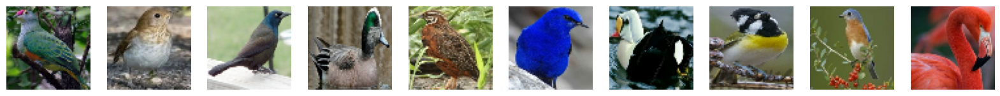

In [16]:
train_sample = sample_batch(train)
display(train_sample)

## Discriminator

In [17]:
discriminator_input = layers.Input(shape= (64,64,3))

x = layers.Conv2D(64, 3, strides=2, padding ="same", use_bias= False)(discriminator_input)
x = layers.BatchNormalization()(x)
x = layers.LeakyReLU()(x)
x = layers.Dropout(0.5)(x)

x = layers.Conv2D(128, 3, strides=2, padding ="same", use_bias= False)(x)
x = layers.BatchNormalization()(x)
x = layers.LeakyReLU()(x)
x = layers.Dropout(0.5)(x)

x = layers.Conv2D(256, 3, strides=2, padding ="same", use_bias= False)(x)
x = layers.BatchNormalization()(x)
x = layers.LeakyReLU()(x)
x = layers.Dropout(0.5)(x)

x = layers.Conv2D(512, 3, strides=2, padding ="same", use_bias= False)(x)
x = layers.BatchNormalization()(x)
x = layers.LeakyReLU()(x)
x = layers.Dropout(0.5)(x)

x = layers.Conv2D(512, 3, strides=2, padding ="same", use_bias= False)(x)
x = layers.BatchNormalization()(x)
x = layers.LeakyReLU()(x)
x = layers.Dropout(0.5)(x)

# x = layers.Conv2D(512, 3, strides=2, padding ="same", use_bias= False)(x)
# x = layers.BatchNormalization()(x)
# x = layers.LeakyReLU()(x)
# x = layers.Dropout(0.5)(x)

x = layers.Conv2D(1,2, strides =1, padding ="valid", use_bias= False, activation ="sigmoid")(x)
discriminator_output = layers.Flatten()(x)

discriminator = keras.Model(discriminator_input, discriminator_output)
discriminator.summary()

Model: "model"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 input_1 (InputLayer)        [(None, 64, 64, 3)]       0         
                                                                 
 conv2d (Conv2D)             (None, 32, 32, 64)        1728      
                                                                 
 batch_normalization (Batch  (None, 32, 32, 64)        256       
 Normalization)                                                  
                                                                 
 leaky_re_lu (LeakyReLU)     (None, 32, 32, 64)        0         
                                                                 
 dropout (Dropout)           (None, 32, 32, 64)        0         
                                                                 
 conv2d_1 (Conv2D)           (None, 16, 16, 128)       73728     
                                                             

## Generator

In [18]:
DIMS = 256

In [19]:
generator_input = layers.Input(shape=(DIMS,))
x = layers.Reshape((1,1,DIMS))(generator_input)

x= layers.UpSampling2D(size= 2)(x)
x = layers.Conv2DTranspose(512, 3, strides =1, use_bias= False, padding = "same")(x)
x = layers.BatchNormalization()(x)
x = layers.LeakyReLU()(x)

x= layers.UpSampling2D(size= 2)(x)
x = layers.Conv2DTranspose(512, 3, strides =1, use_bias= False, padding = "same")(x)
x = layers.BatchNormalization()(x)
x = layers.LeakyReLU()(x)

x= layers.UpSampling2D(size= 2)(x)
x = layers.Conv2DTranspose(256, 3, strides =1, use_bias= False, padding = "same")(x)
x = layers.BatchNormalization()(x)
x = layers.LeakyReLU()(x)

x= layers.UpSampling2D(size= 2)(x)
x = layers.Conv2DTranspose(128, 3, strides =1, use_bias= False, padding = "same")(x)
x = layers.BatchNormalization()(x)
x = layers.LeakyReLU()(x)

x= layers.UpSampling2D(size= 2)(x)
x = layers.Conv2DTranspose(64, 3, strides =1, use_bias= False, padding = "same")(x)
x = layers.BatchNormalization()(x)
x = layers.LeakyReLU()(x)

generator_output= layers.Conv2DTranspose(3, 4, strides =2, use_bias= False, activation= "tanh", padding ="same" )(x)

generator = keras.Model(generator_input, generator_output)
generator.summary()

Model: "model_1"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 input_2 (InputLayer)        [(None, 256)]             0         
                                                                 
 reshape (Reshape)           (None, 1, 1, 256)         0         
                                                                 
 up_sampling2d (UpSampling2  (None, 2, 2, 256)         0         
 D)                                                              
                                                                 
 conv2d_transpose (Conv2DTr  (None, 2, 2, 512)         1179648   
 anspose)                                                        
                                                                 
 batch_normalization_5 (Bat  (None, 2, 2, 512)         2048      
 chNormalization)                                                
                                                           

In [20]:
class DCGAN(keras.Model):
  def __init__(self, discriminator, generator, latent_dim):
    super(DCGAN, self).__init__()
    self.discriminator = discriminator
    self.generator = generator
    self.latent_dim = latent_dim

  def compile(self, d_optimizer, g_optimizer):
    super(DCGAN, self).compile()
    self.loss_fn = losses.BinaryCrossentropy()
    self.d_optimizer = d_optimizer
    self.g_optimizer = g_optimizer
    self.d_loss_metric = metrics.Mean(name="d_loss")
    self.d_real_acc_metric = metrics.BinaryAccuracy(name="d_real_acc")
    self.d_fake_acc_metric = metrics.BinaryAccuracy(name="d_fake_acc")
    self.d_acc_metric = metrics.BinaryAccuracy(name="d_acc")
    self.g_loss_metric = metrics.Mean(name="g_loss")
    self.g_acc_metric = metrics.BinaryAccuracy(name="g_acc")

  @property
  def metrics(self):
    return[
        self.d_loss_metric,
        self.d_real_acc_metric,
        self.d_fake_acc_metric,
        self.d_acc_metric,
        self.g_loss_metric,
        self.g_acc_metric,
    ]

  def train_step(self, real_images):
    batch_size = tf.shape(real_images)[0]
    random_latent_vectors= tf.random.normal(shape=(batch_size, self.latent_dim))

    with tf.GradientTape() as gen_tape, tf.GradientTape() as disc_tape:
      generated_images = self.generator(random_latent_vectors, training = True)
      real_prediction = self.discriminator(real_images, training = True)
      fake_prediction = self.discriminator(generated_images, training = True)
      real_labels = tf.ones_like(real_prediction)
      fake_labels = tf.zeros_like(fake_prediction)
      real_noisy_labels = real_labels - 0.1*tf.random.uniform(tf.shape(real_prediction))
      fake_noisy_labels = fake_labels + 0.1*tf.random.uniform(tf.shape(fake_prediction))

      d_real_loss = self.loss_fn(real_noisy_labels, real_prediction)
      d_fake_loss = self.loss_fn(fake_noisy_labels, fake_prediction)
      d_loss = (d_real_loss + d_fake_loss)/2.0

      g_loss = self.loss_fn(real_labels, fake_prediction)

    gradient_of_discriminator = disc_tape.gradient(
        d_loss, self.discriminator.trainable_variables
    )

    gradient_of_generator = gen_tape.gradient(
        g_loss, self.generator.trainable_variables
    )

    self.d_optimizer.apply_gradients(
        zip(gradient_of_discriminator, self.discriminator.trainable_variables)
    )

    self.g_optimizer.apply_gradients(
        zip(gradient_of_generator, self.generator.trainable_variables)
    )
    self.d_loss_metric.update_state(d_loss)
    self.d_real_acc_metric.update_state(real_labels, real_prediction)
    self.d_fake_acc_metric.update_state(fake_labels, fake_prediction)
    self.d_acc_metric.update_state(
        [real_labels, fake_labels], [real_prediction, fake_prediction]
    )
    self.g_loss_metric.update_state(g_loss)
    self.g_acc_metric.update_state(real_labels, fake_prediction)

    return {m.name: m.result() for m in self.metrics}


In [21]:
dcgan = DCGAN(discriminator = discriminator, generator= generator, latent_dim = DIMS)

In [22]:
dcgan.compile(
    d_optimizer = optimizers.Adam(learning_rate= 0.0002, beta_1 = 0.5, beta_2 = 0.99),
    g_optimizer = optimizers.Adam(learning_rate = 0.0002, beta_1 = 0.6, beta_2 = 0.99),
)

In [23]:
model_checkpoint_callback = callbacks.ModelCheckpoint(
    filepath="./checkpoint/checkpoint.ckpt",
    save_weights_only=True,
    save_freq="epoch",
    verbose=0,
)

tensorboard_callback = callbacks.TensorBoard(log_dir="./logs")


class ImageGenerator(callbacks.Callback):
    def __init__(self, num_img, latent_dim):
        self.num_img = num_img
        self.latent_dim = latent_dim

    def on_epoch_end(self, epoch, logs=None):
        random_latent_vectors = tf.random.normal(
            shape=(self.num_img, self.latent_dim)
        )
        generated_images = self.model.generator(random_latent_vectors)
        generated_images = generated_images
        generated_images = generated_images.numpy()
        display(
            generated_images,
            save_to="./output/generated_img_%03d.png" % (epoch),
        )

In [24]:
! mkdir output/

Epoch 1/50
  6/662 [..............................] - ETA: 1:42 - d_loss: 0.8367 - d_real_acc: 0.5742 - d_fake_acc: 0.5690 - d_acc: 0.5716 - g_loss: 1.0649 - g_acc: 0.4310

662/662 [==============================] - ETA: 0s - d_loss: 0.4423 - d_real_acc: 0.8645 - d_fake_acc: 0.8558 - d_acc: 0.8601 - g_loss: 2.5409 - g_acc: 0.1442
Saved to ./output/generated_img_000.png


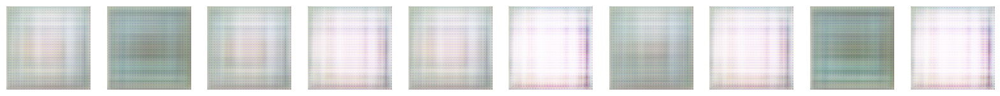

662/662 [==============================] - 130s 165ms/step - d_loss: 0.4423 - d_real_acc: 0.8645 - d_fake_acc: 0.8558 - d_acc: 0.8601 - g_loss: 2.5409 - g_acc: 0.1442
Epoch 2/50
662/662 [==============================] - ETA: 0s - d_loss: 0.2835 - d_real_acc: 0.9654 - d_fake_acc: 0.9661 - d_acc: 0.9657 - g_loss: 2.9977 - g_acc: 0.0339
Saved to ./output/generated_img_001.png


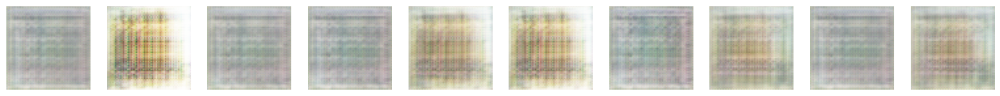

662/662 [==============================] - 110s 165ms/step - d_loss: 0.2835 - d_real_acc: 0.9654 - d_fake_acc: 0.9661 - d_acc: 0.9657 - g_loss: 2.9977 - g_acc: 0.0339
Epoch 3/50
662/662 [==============================] - ETA: 0s - d_loss: 0.3275 - d_real_acc: 0.9356 - d_fake_acc: 0.9355 - d_acc: 0.9356 - g_loss: 2.5527 - g_acc: 0.0645
Saved to ./output/generated_img_002.png


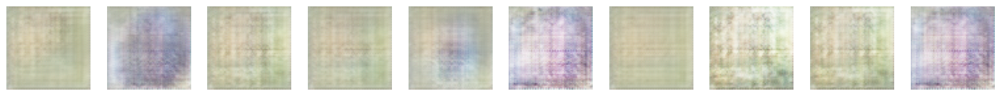

662/662 [==============================] - 110s 166ms/step - d_loss: 0.3275 - d_real_acc: 0.9356 - d_fake_acc: 0.9355 - d_acc: 0.9356 - g_loss: 2.5527 - g_acc: 0.0645
Epoch 4/50
661/662 [============================>.] - ETA: 0s - d_loss: 0.3255 - d_real_acc: 0.9374 - d_fake_acc: 0.9307 - d_acc: 0.9341 - g_loss: 2.7252 - g_acc: 0.0693
Saved to ./output/generated_img_003.png


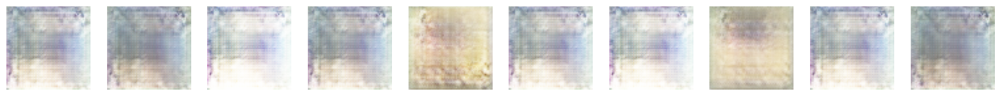

662/662 [==============================] - 110s 166ms/step - d_loss: 0.3254 - d_real_acc: 0.9374 - d_fake_acc: 0.9307 - d_acc: 0.9341 - g_loss: 2.7248 - g_acc: 0.0693
Epoch 5/50
661/662 [============================>.] - ETA: 0s - d_loss: 0.3073 - d_real_acc: 0.9471 - d_fake_acc: 0.9489 - d_acc: 0.9480 - g_loss: 2.7735 - g_acc: 0.0511
Saved to ./output/generated_img_004.png


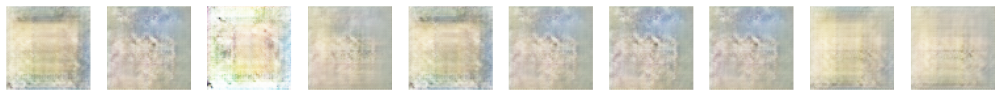

662/662 [==============================] - 111s 167ms/step - d_loss: 0.3072 - d_real_acc: 0.9471 - d_fake_acc: 0.9489 - d_acc: 0.9480 - g_loss: 2.7726 - g_acc: 0.0511
Epoch 6/50
662/662 [==============================] - ETA: 0s - d_loss: 0.3020 - d_real_acc: 0.9505 - d_fake_acc: 0.9551 - d_acc: 0.9528 - g_loss: 2.7745 - g_acc: 0.0449
Saved to ./output/generated_img_005.png


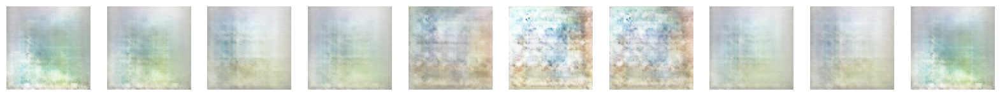

662/662 [==============================] - 110s 166ms/step - d_loss: 0.3020 - d_real_acc: 0.9505 - d_fake_acc: 0.9551 - d_acc: 0.9528 - g_loss: 2.7745 - g_acc: 0.0449
Epoch 7/50
662/662 [==============================] - ETA: 0s - d_loss: 0.2953 - d_real_acc: 0.9570 - d_fake_acc: 0.9588 - d_acc: 0.9579 - g_loss: 2.7944 - g_acc: 0.0412
Saved to ./output/generated_img_006.png


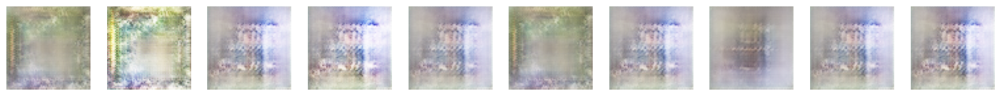

662/662 [==============================] - 110s 166ms/step - d_loss: 0.2953 - d_real_acc: 0.9570 - d_fake_acc: 0.9588 - d_acc: 0.9579 - g_loss: 2.7944 - g_acc: 0.0412
Epoch 8/50
661/662 [============================>.] - ETA: 0s - d_loss: 0.2904 - d_real_acc: 0.9620 - d_fake_acc: 0.9620 - d_acc: 0.9620 - g_loss: 2.8475 - g_acc: 0.0380
Saved to ./output/generated_img_007.png


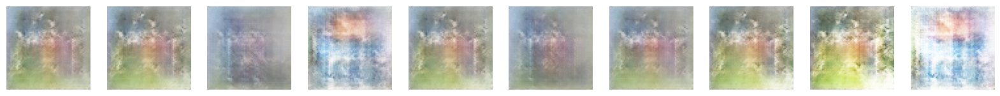

662/662 [==============================] - 111s 166ms/step - d_loss: 0.2919 - d_real_acc: 0.9620 - d_fake_acc: 0.9617 - d_acc: 0.9619 - g_loss: 2.8434 - g_acc: 0.0383
Epoch 9/50
661/662 [============================>.] - ETA: 0s - d_loss: 0.2807 - d_real_acc: 0.9655 - d_fake_acc: 0.9720 - d_acc: 0.9688 - g_loss: 2.8490 - g_acc: 0.0280
Saved to ./output/generated_img_008.png


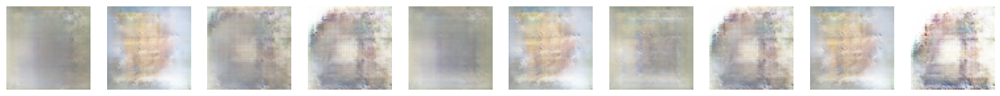

662/662 [==============================] - 110s 165ms/step - d_loss: 0.2813 - d_real_acc: 0.9653 - d_fake_acc: 0.9720 - d_acc: 0.9686 - g_loss: 2.8529 - g_acc: 0.0280
Epoch 10/50
662/662 [==============================] - ETA: 0s - d_loss: 0.2765 - d_real_acc: 0.9703 - d_fake_acc: 0.9720 - d_acc: 0.9712 - g_loss: 2.9264 - g_acc: 0.0280
Saved to ./output/generated_img_009.png


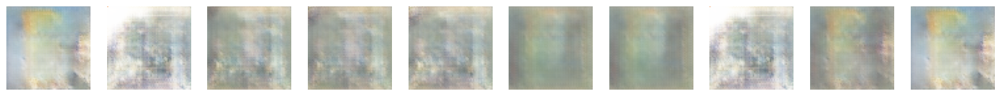

662/662 [==============================] - 110s 166ms/step - d_loss: 0.2765 - d_real_acc: 0.9703 - d_fake_acc: 0.9720 - d_acc: 0.9712 - g_loss: 2.9264 - g_acc: 0.0280
Epoch 11/50
662/662 [==============================] - ETA: 0s - d_loss: 0.2855 - d_real_acc: 0.9645 - d_fake_acc: 0.9647 - d_acc: 0.9646 - g_loss: 2.8979 - g_acc: 0.0353
Saved to ./output/generated_img_010.png


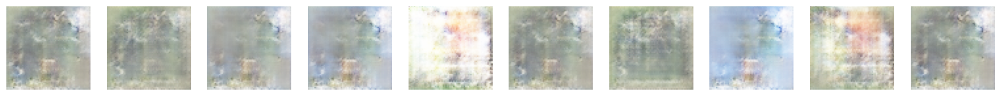

662/662 [==============================] - 111s 166ms/step - d_loss: 0.2855 - d_real_acc: 0.9645 - d_fake_acc: 0.9647 - d_acc: 0.9646 - g_loss: 2.8979 - g_acc: 0.0353
Epoch 12/50
662/662 [==============================] - ETA: 0s - d_loss: 0.2743 - d_real_acc: 0.9722 - d_fake_acc: 0.9746 - d_acc: 0.9734 - g_loss: 2.9277 - g_acc: 0.0254
Saved to ./output/generated_img_011.png


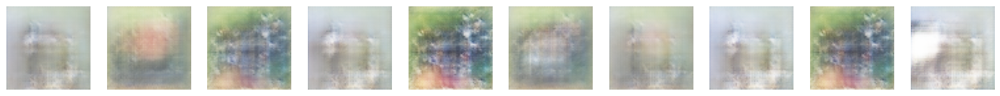

662/662 [==============================] - 110s 166ms/step - d_loss: 0.2743 - d_real_acc: 0.9722 - d_fake_acc: 0.9746 - d_acc: 0.9734 - g_loss: 2.9277 - g_acc: 0.0254
Epoch 13/50
662/662 [==============================] - ETA: 0s - d_loss: 0.2741 - d_real_acc: 0.9721 - d_fake_acc: 0.9726 - d_acc: 0.9724 - g_loss: 2.9909 - g_acc: 0.0274
Saved to ./output/generated_img_012.png


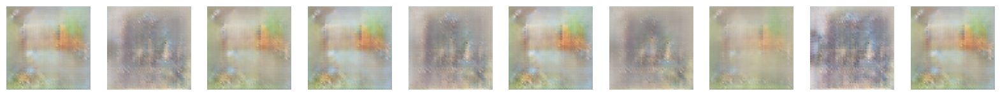

662/662 [==============================] - 111s 166ms/step - d_loss: 0.2741 - d_real_acc: 0.9721 - d_fake_acc: 0.9726 - d_acc: 0.9724 - g_loss: 2.9909 - g_acc: 0.0274
Epoch 14/50
662/662 [==============================] - ETA: 0s - d_loss: 0.2744 - d_real_acc: 0.9717 - d_fake_acc: 0.9725 - d_acc: 0.9721 - g_loss: 2.9261 - g_acc: 0.0275
Saved to ./output/generated_img_013.png


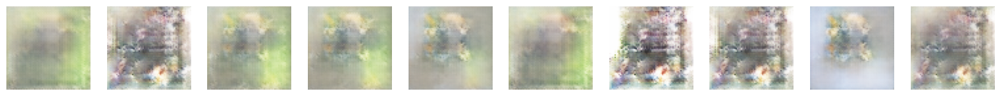

662/662 [==============================] - 111s 167ms/step - d_loss: 0.2744 - d_real_acc: 0.9717 - d_fake_acc: 0.9725 - d_acc: 0.9721 - g_loss: 2.9261 - g_acc: 0.0275
Epoch 15/50
662/662 [==============================] - ETA: 0s - d_loss: 0.2767 - d_real_acc: 0.9715 - d_fake_acc: 0.9709 - d_acc: 0.9712 - g_loss: 2.9509 - g_acc: 0.0291
Saved to ./output/generated_img_014.png


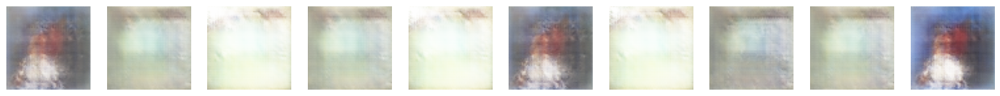

662/662 [==============================] - 111s 167ms/step - d_loss: 0.2767 - d_real_acc: 0.9715 - d_fake_acc: 0.9709 - d_acc: 0.9712 - g_loss: 2.9509 - g_acc: 0.0291
Epoch 16/50
662/662 [==============================] - ETA: 0s - d_loss: 0.2696 - d_real_acc: 0.9752 - d_fake_acc: 0.9756 - d_acc: 0.9754 - g_loss: 2.9491 - g_acc: 0.0244
Saved to ./output/generated_img_015.png


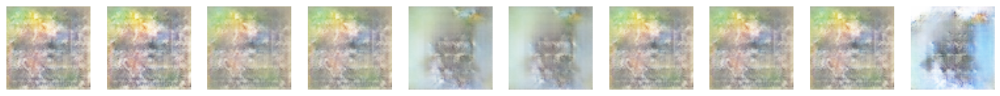

662/662 [==============================] - 111s 167ms/step - d_loss: 0.2696 - d_real_acc: 0.9752 - d_fake_acc: 0.9756 - d_acc: 0.9754 - g_loss: 2.9491 - g_acc: 0.0244
Epoch 17/50
662/662 [==============================] - ETA: 0s - d_loss: 0.2630 - d_real_acc: 0.9798 - d_fake_acc: 0.9803 - d_acc: 0.9801 - g_loss: 2.9949 - g_acc: 0.0197
Saved to ./output/generated_img_016.png


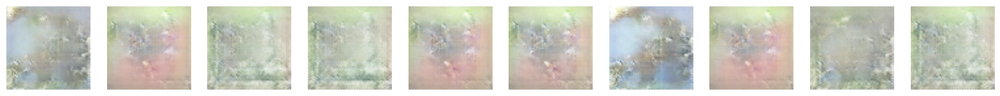

662/662 [==============================] - 111s 167ms/step - d_loss: 0.2630 - d_real_acc: 0.9798 - d_fake_acc: 0.9803 - d_acc: 0.9801 - g_loss: 2.9949 - g_acc: 0.0197
Epoch 18/50
662/662 [==============================] - ETA: 0s - d_loss: 0.2628 - d_real_acc: 0.9799 - d_fake_acc: 0.9810 - d_acc: 0.9805 - g_loss: 2.9988 - g_acc: 0.0190
Saved to ./output/generated_img_017.png


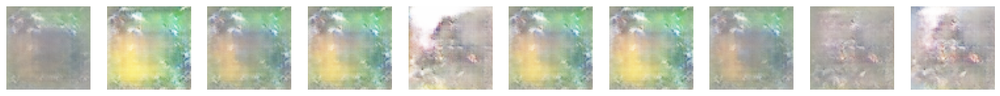

662/662 [==============================] - 111s 167ms/step - d_loss: 0.2628 - d_real_acc: 0.9799 - d_fake_acc: 0.9810 - d_acc: 0.9805 - g_loss: 2.9988 - g_acc: 0.0190
Epoch 19/50
662/662 [==============================] - ETA: 0s - d_loss: 0.2643 - d_real_acc: 0.9793 - d_fake_acc: 0.9781 - d_acc: 0.9787 - g_loss: 3.0178 - g_acc: 0.0219
Saved to ./output/generated_img_018.png


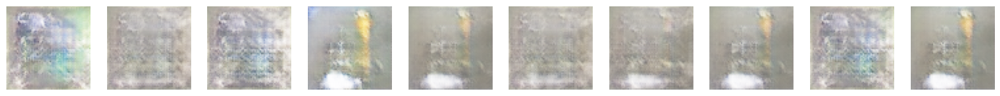

662/662 [==============================] - 112s 168ms/step - d_loss: 0.2643 - d_real_acc: 0.9793 - d_fake_acc: 0.9781 - d_acc: 0.9787 - g_loss: 3.0178 - g_acc: 0.0219
Epoch 20/50
662/662 [==============================] - ETA: 0s - d_loss: 0.2562 - d_real_acc: 0.9845 - d_fake_acc: 0.9843 - d_acc: 0.9844 - g_loss: 3.1046 - g_acc: 0.0157
Saved to ./output/generated_img_019.png


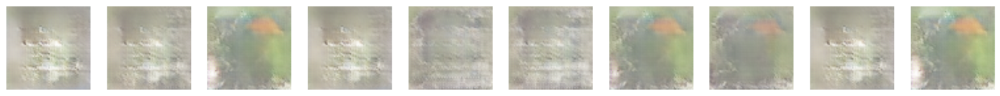

662/662 [==============================] - 111s 168ms/step - d_loss: 0.2562 - d_real_acc: 0.9845 - d_fake_acc: 0.9843 - d_acc: 0.9844 - g_loss: 3.1046 - g_acc: 0.0157
Epoch 21/50
662/662 [==============================] - ETA: 0s - d_loss: 0.2651 - d_real_acc: 0.9796 - d_fake_acc: 0.9786 - d_acc: 0.9791 - g_loss: 3.0239 - g_acc: 0.0214
Saved to ./output/generated_img_020.png


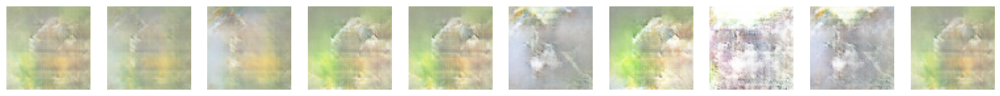

662/662 [==============================] - 112s 168ms/step - d_loss: 0.2651 - d_real_acc: 0.9796 - d_fake_acc: 0.9786 - d_acc: 0.9791 - g_loss: 3.0239 - g_acc: 0.0214
Epoch 22/50
662/662 [==============================] - ETA: 0s - d_loss: 0.2676 - d_real_acc: 0.9769 - d_fake_acc: 0.9773 - d_acc: 0.9771 - g_loss: 2.9303 - g_acc: 0.0227
Saved to ./output/generated_img_021.png


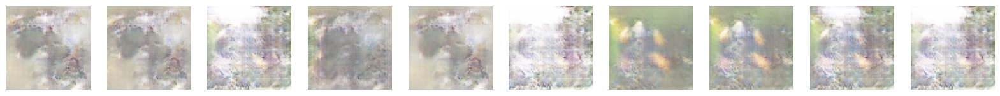

662/662 [==============================] - 112s 169ms/step - d_loss: 0.2676 - d_real_acc: 0.9769 - d_fake_acc: 0.9773 - d_acc: 0.9771 - g_loss: 2.9303 - g_acc: 0.0227
Epoch 23/50
662/662 [==============================] - ETA: 0s - d_loss: 0.2615 - d_real_acc: 0.9810 - d_fake_acc: 0.9807 - d_acc: 0.9809 - g_loss: 3.0144 - g_acc: 0.0193
Saved to ./output/generated_img_022.png


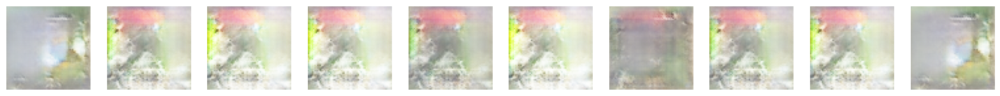

662/662 [==============================] - 112s 168ms/step - d_loss: 0.2615 - d_real_acc: 0.9810 - d_fake_acc: 0.9807 - d_acc: 0.9809 - g_loss: 3.0144 - g_acc: 0.0193
Epoch 24/50
662/662 [==============================] - ETA: 0s - d_loss: 0.2616 - d_real_acc: 0.9798 - d_fake_acc: 0.9807 - d_acc: 0.9802 - g_loss: 2.9936 - g_acc: 0.0193
Saved to ./output/generated_img_023.png


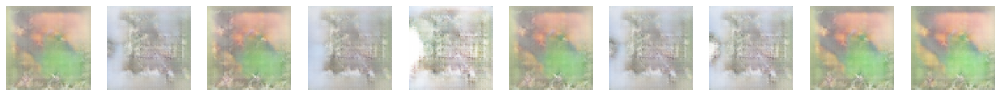

662/662 [==============================] - 112s 169ms/step - d_loss: 0.2616 - d_real_acc: 0.9798 - d_fake_acc: 0.9807 - d_acc: 0.9802 - g_loss: 2.9936 - g_acc: 0.0193
Epoch 25/50
662/662 [==============================] - ETA: 0s - d_loss: 0.2595 - d_real_acc: 0.9829 - d_fake_acc: 0.9811 - d_acc: 0.9820 - g_loss: 3.0055 - g_acc: 0.0189
Saved to ./output/generated_img_024.png


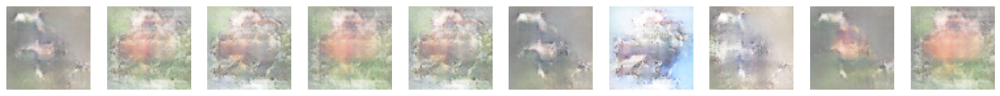

662/662 [==============================] - 113s 169ms/step - d_loss: 0.2595 - d_real_acc: 0.9829 - d_fake_acc: 0.9811 - d_acc: 0.9820 - g_loss: 3.0055 - g_acc: 0.0189
Epoch 26/50
662/662 [==============================] - ETA: 0s - d_loss: 0.2589 - d_real_acc: 0.9812 - d_fake_acc: 0.9822 - d_acc: 0.9817 - g_loss: 3.0431 - g_acc: 0.0178
Saved to ./output/generated_img_025.png


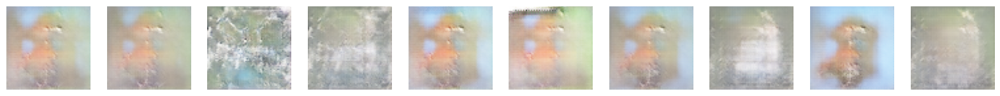

662/662 [==============================] - 113s 169ms/step - d_loss: 0.2589 - d_real_acc: 0.9812 - d_fake_acc: 0.9822 - d_acc: 0.9817 - g_loss: 3.0431 - g_acc: 0.0178
Epoch 27/50
662/662 [==============================] - ETA: 0s - d_loss: 0.2537 - d_real_acc: 0.9867 - d_fake_acc: 0.9872 - d_acc: 0.9869 - g_loss: 3.0454 - g_acc: 0.0128
Saved to ./output/generated_img_026.png


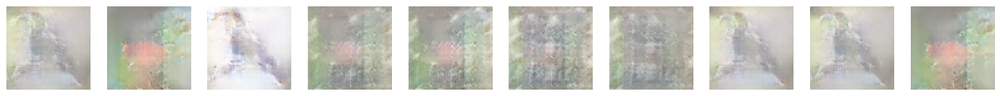

662/662 [==============================] - 114s 171ms/step - d_loss: 0.2537 - d_real_acc: 0.9867 - d_fake_acc: 0.9872 - d_acc: 0.9869 - g_loss: 3.0454 - g_acc: 0.0128
Epoch 28/50
662/662 [==============================] - ETA: 0s - d_loss: 0.2620 - d_real_acc: 0.9827 - d_fake_acc: 0.9801 - d_acc: 0.9814 - g_loss: 3.0272 - g_acc: 0.0199
Saved to ./output/generated_img_027.png


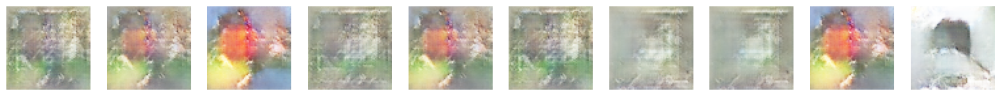

662/662 [==============================] - 114s 171ms/step - d_loss: 0.2620 - d_real_acc: 0.9827 - d_fake_acc: 0.9801 - d_acc: 0.9814 - g_loss: 3.0272 - g_acc: 0.0199
Epoch 29/50
662/662 [==============================] - ETA: 0s - d_loss: 0.2550 - d_real_acc: 0.9854 - d_fake_acc: 0.9842 - d_acc: 0.9848 - g_loss: 3.0496 - g_acc: 0.0158
Saved to ./output/generated_img_028.png


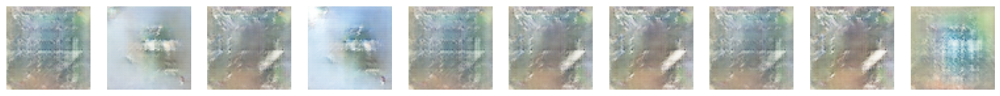

662/662 [==============================] - 114s 171ms/step - d_loss: 0.2550 - d_real_acc: 0.9854 - d_fake_acc: 0.9842 - d_acc: 0.9848 - g_loss: 3.0496 - g_acc: 0.0158
Epoch 30/50
662/662 [==============================] - ETA: 0s - d_loss: 0.2507 - d_real_acc: 0.9883 - d_fake_acc: 0.9845 - d_acc: 0.9864 - g_loss: 3.0749 - g_acc: 0.0155
Saved to ./output/generated_img_029.png


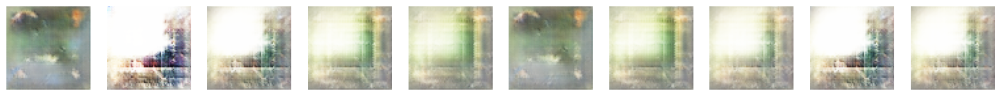

662/662 [==============================] - 114s 171ms/step - d_loss: 0.2507 - d_real_acc: 0.9883 - d_fake_acc: 0.9845 - d_acc: 0.9864 - g_loss: 3.0749 - g_acc: 0.0155
Epoch 31/50
662/662 [==============================] - ETA: 0s - d_loss: 0.2590 - d_real_acc: 0.9832 - d_fake_acc: 0.9798 - d_acc: 0.9815 - g_loss: 2.9990 - g_acc: 0.0202
Saved to ./output/generated_img_030.png


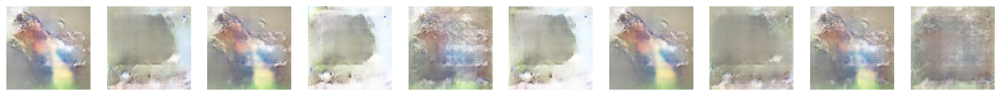

662/662 [==============================] - 114s 172ms/step - d_loss: 0.2590 - d_real_acc: 0.9832 - d_fake_acc: 0.9798 - d_acc: 0.9815 - g_loss: 2.9990 - g_acc: 0.0202
Epoch 32/50
662/662 [==============================] - ETA: 0s - d_loss: 0.2570 - d_real_acc: 0.9849 - d_fake_acc: 0.9817 - d_acc: 0.9833 - g_loss: 3.0216 - g_acc: 0.0183
Saved to ./output/generated_img_031.png


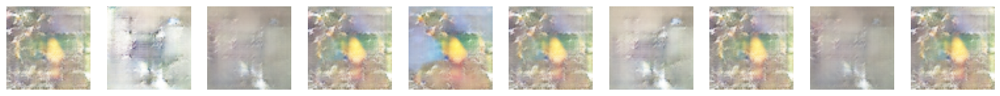

662/662 [==============================] - 115s 172ms/step - d_loss: 0.2570 - d_real_acc: 0.9849 - d_fake_acc: 0.9817 - d_acc: 0.9833 - g_loss: 3.0216 - g_acc: 0.0183
Epoch 33/50
661/662 [============================>.] - ETA: 0s - d_loss: 0.2503 - d_real_acc: 0.9881 - d_fake_acc: 0.9884 - d_acc: 0.9882 - g_loss: 3.1070 - g_acc: 0.0116
Saved to ./output/generated_img_032.png


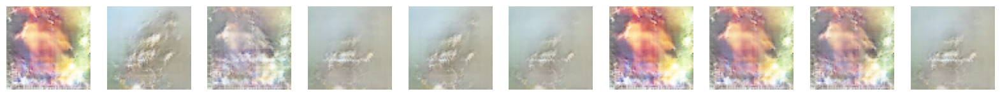

662/662 [==============================] - 115s 173ms/step - d_loss: 0.2504 - d_real_acc: 0.9881 - d_fake_acc: 0.9883 - d_acc: 0.9882 - g_loss: 3.1049 - g_acc: 0.0117
Epoch 34/50
662/662 [==============================] - ETA: 0s - d_loss: 0.2484 - d_real_acc: 0.9886 - d_fake_acc: 0.9877 - d_acc: 0.9881 - g_loss: 3.0593 - g_acc: 0.0123
Saved to ./output/generated_img_033.png


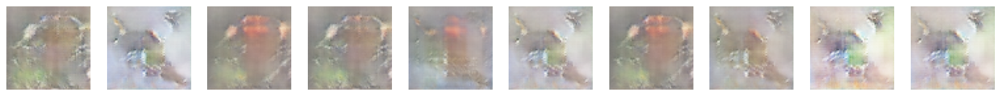

662/662 [==============================] - 115s 172ms/step - d_loss: 0.2484 - d_real_acc: 0.9886 - d_fake_acc: 0.9877 - d_acc: 0.9881 - g_loss: 3.0593 - g_acc: 0.0123
Epoch 35/50
662/662 [==============================] - ETA: 0s - d_loss: 0.2488 - d_real_acc: 0.9889 - d_fake_acc: 0.9867 - d_acc: 0.9878 - g_loss: 3.1317 - g_acc: 0.0133
Saved to ./output/generated_img_034.png


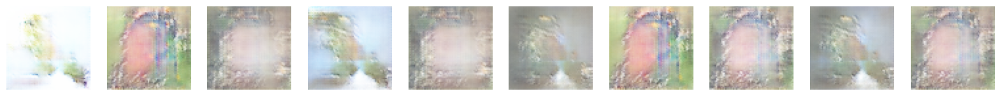

662/662 [==============================] - 115s 172ms/step - d_loss: 0.2488 - d_real_acc: 0.9889 - d_fake_acc: 0.9867 - d_acc: 0.9878 - g_loss: 3.1317 - g_acc: 0.0133
Epoch 36/50
662/662 [==============================] - ETA: 0s - d_loss: 0.2502 - d_real_acc: 0.9897 - d_fake_acc: 0.9881 - d_acc: 0.9889 - g_loss: 3.0900 - g_acc: 0.0119
Saved to ./output/generated_img_035.png


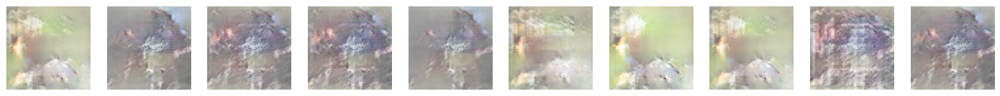

662/662 [==============================] - 115s 172ms/step - d_loss: 0.2502 - d_real_acc: 0.9897 - d_fake_acc: 0.9881 - d_acc: 0.9889 - g_loss: 3.0900 - g_acc: 0.0119
Epoch 37/50
662/662 [==============================] - ETA: 0s - d_loss: 0.2497 - d_real_acc: 0.9883 - d_fake_acc: 0.9861 - d_acc: 0.9872 - g_loss: 3.0486 - g_acc: 0.0139
Saved to ./output/generated_img_036.png


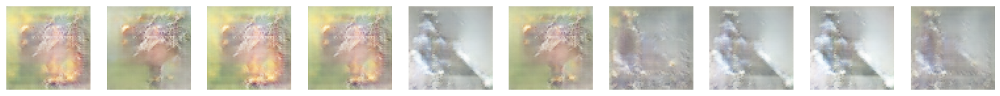

662/662 [==============================] - 115s 173ms/step - d_loss: 0.2497 - d_real_acc: 0.9883 - d_fake_acc: 0.9861 - d_acc: 0.9872 - g_loss: 3.0486 - g_acc: 0.0139
Epoch 38/50
662/662 [==============================] - ETA: 0s - d_loss: 0.2466 - d_real_acc: 0.9901 - d_fake_acc: 0.9896 - d_acc: 0.9898 - g_loss: 3.1168 - g_acc: 0.0104
Saved to ./output/generated_img_037.png


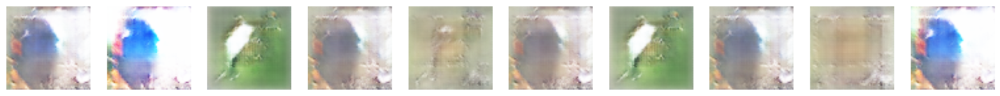

662/662 [==============================] - 115s 173ms/step - d_loss: 0.2466 - d_real_acc: 0.9901 - d_fake_acc: 0.9896 - d_acc: 0.9898 - g_loss: 3.1168 - g_acc: 0.0104
Epoch 39/50
662/662 [==============================] - ETA: 0s - d_loss: 0.2479 - d_real_acc: 0.9898 - d_fake_acc: 0.9878 - d_acc: 0.9888 - g_loss: 3.1103 - g_acc: 0.0122
Saved to ./output/generated_img_038.png


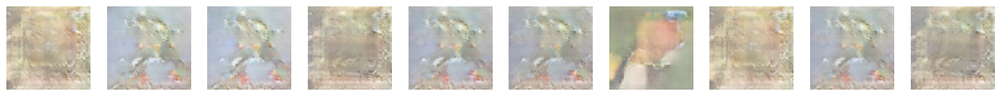

662/662 [==============================] - 115s 173ms/step - d_loss: 0.2479 - d_real_acc: 0.9898 - d_fake_acc: 0.9878 - d_acc: 0.9888 - g_loss: 3.1103 - g_acc: 0.0122
Epoch 40/50
662/662 [==============================] - ETA: 0s - d_loss: 0.2428 - d_real_acc: 0.9925 - d_fake_acc: 0.9909 - d_acc: 0.9917 - g_loss: 3.0957 - g_acc: 0.0091
Saved to ./output/generated_img_039.png


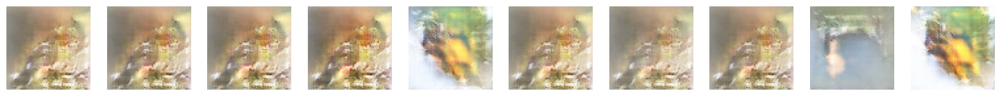

662/662 [==============================] - 115s 173ms/step - d_loss: 0.2428 - d_real_acc: 0.9925 - d_fake_acc: 0.9909 - d_acc: 0.9917 - g_loss: 3.0957 - g_acc: 0.0091
Epoch 41/50
662/662 [==============================] - ETA: 0s - d_loss: 0.2463 - d_real_acc: 0.9886 - d_fake_acc: 0.9888 - d_acc: 0.9887 - g_loss: 3.0742 - g_acc: 0.0112
Saved to ./output/generated_img_040.png


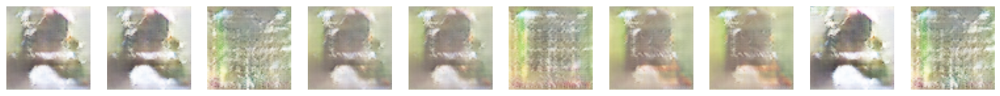

662/662 [==============================] - 115s 172ms/step - d_loss: 0.2463 - d_real_acc: 0.9886 - d_fake_acc: 0.9888 - d_acc: 0.9887 - g_loss: 3.0742 - g_acc: 0.0112
Epoch 42/50
662/662 [==============================] - ETA: 0s - d_loss: 0.2479 - d_real_acc: 0.9895 - d_fake_acc: 0.9888 - d_acc: 0.9891 - g_loss: 3.0887 - g_acc: 0.0112
Saved to ./output/generated_img_041.png


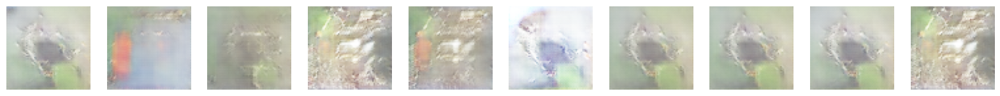

662/662 [==============================] - 115s 172ms/step - d_loss: 0.2479 - d_real_acc: 0.9895 - d_fake_acc: 0.9888 - d_acc: 0.9891 - g_loss: 3.0887 - g_acc: 0.0112
Epoch 43/50
662/662 [==============================] - ETA: 0s - d_loss: 0.2454 - d_real_acc: 0.9917 - d_fake_acc: 0.9899 - d_acc: 0.9908 - g_loss: 3.1065 - g_acc: 0.0101
Saved to ./output/generated_img_042.png


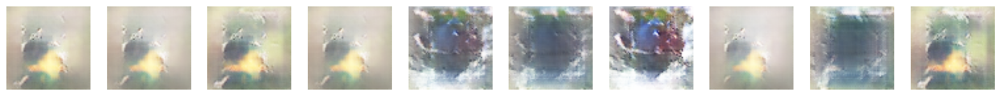

662/662 [==============================] - 115s 172ms/step - d_loss: 0.2454 - d_real_acc: 0.9917 - d_fake_acc: 0.9899 - d_acc: 0.9908 - g_loss: 3.1065 - g_acc: 0.0101
Epoch 44/50
662/662 [==============================] - ETA: 0s - d_loss: 0.2493 - d_real_acc: 0.9873 - d_fake_acc: 0.9872 - d_acc: 0.9872 - g_loss: 3.0603 - g_acc: 0.0128
Saved to ./output/generated_img_043.png


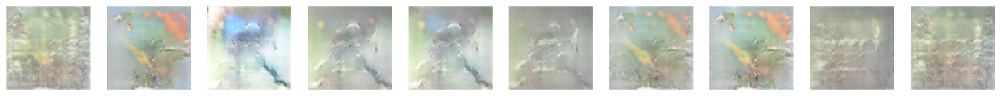

662/662 [==============================] - 114s 171ms/step - d_loss: 0.2493 - d_real_acc: 0.9873 - d_fake_acc: 0.9872 - d_acc: 0.9872 - g_loss: 3.0603 - g_acc: 0.0128
Epoch 45/50
662/662 [==============================] - ETA: 0s - d_loss: 0.2412 - d_real_acc: 0.9918 - d_fake_acc: 0.9928 - d_acc: 0.9923 - g_loss: 3.0724 - g_acc: 0.0072
Saved to ./output/generated_img_044.png


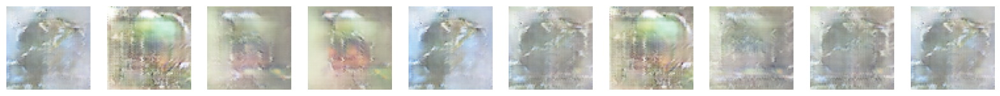

662/662 [==============================] - 114s 171ms/step - d_loss: 0.2412 - d_real_acc: 0.9918 - d_fake_acc: 0.9928 - d_acc: 0.9923 - g_loss: 3.0724 - g_acc: 0.0072
Epoch 46/50
662/662 [==============================] - ETA: 0s - d_loss: 0.2444 - d_real_acc: 0.9905 - d_fake_acc: 0.9888 - d_acc: 0.9896 - g_loss: 3.1015 - g_acc: 0.0112
Saved to ./output/generated_img_045.png


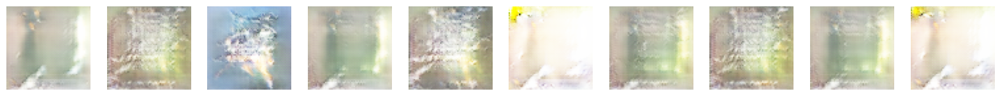

662/662 [==============================] - 115s 172ms/step - d_loss: 0.2444 - d_real_acc: 0.9905 - d_fake_acc: 0.9888 - d_acc: 0.9896 - g_loss: 3.1015 - g_acc: 0.0112
Epoch 47/50
662/662 [==============================] - ETA: 0s - d_loss: 0.2408 - d_real_acc: 0.9916 - d_fake_acc: 0.9924 - d_acc: 0.9920 - g_loss: 3.1016 - g_acc: 0.0076
Saved to ./output/generated_img_046.png


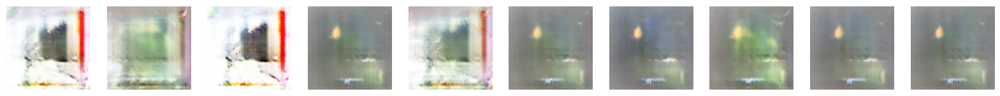

662/662 [==============================] - 115s 172ms/step - d_loss: 0.2408 - d_real_acc: 0.9916 - d_fake_acc: 0.9924 - d_acc: 0.9920 - g_loss: 3.1016 - g_acc: 0.0076
Epoch 48/50
662/662 [==============================] - ETA: 0s - d_loss: 0.2395 - d_real_acc: 0.9946 - d_fake_acc: 0.9887 - d_acc: 0.9916 - g_loss: 3.1036 - g_acc: 0.0113
Saved to ./output/generated_img_047.png


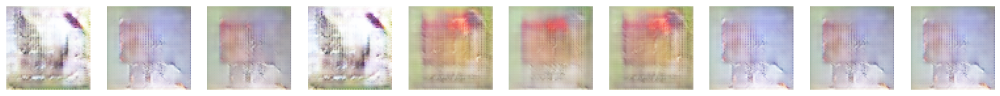

662/662 [==============================] - 114s 171ms/step - d_loss: 0.2395 - d_real_acc: 0.9946 - d_fake_acc: 0.9887 - d_acc: 0.9916 - g_loss: 3.1036 - g_acc: 0.0113
Epoch 49/50
662/662 [==============================] - ETA: 0s - d_loss: 0.2377 - d_real_acc: 0.9943 - d_fake_acc: 0.9947 - d_acc: 0.9945 - g_loss: 3.0992 - g_acc: 0.0053
Saved to ./output/generated_img_048.png


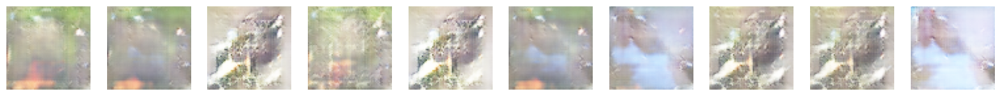

662/662 [==============================] - 114s 171ms/step - d_loss: 0.2377 - d_real_acc: 0.9943 - d_fake_acc: 0.9947 - d_acc: 0.9945 - g_loss: 3.0992 - g_acc: 0.0053
Epoch 50/50
662/662 [==============================] - ETA: 0s - d_loss: 0.2442 - d_real_acc: 0.9909 - d_fake_acc: 0.9884 - d_acc: 0.9896 - g_loss: 3.0800 - g_acc: 0.0116
Saved to ./output/generated_img_049.png


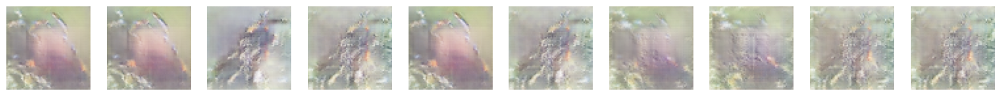

662/662 [==============================] - 114s 171ms/step - d_loss: 0.2442 - d_real_acc: 0.9909 - d_fake_acc: 0.9884 - d_acc: 0.9896 - g_loss: 3.0800 - g_acc: 0.0116


In [25]:
dcgan.fit(
    train,
    epochs=50,
    callbacks=[
        model_checkpoint_callback,
        tensorboard_callback,
        ImageGenerator(num_img=10, latent_dim=DIMS),
    ],
)

## Generating new images

In [26]:
grid_width, grid_height = (10,3)
z_sample= np.random.normal(size=(grid_height* grid_width, DIMS))

In [27]:
reconstructions = generator.predict(z_sample)

1/1 [==============================] - 1s 887ms/step


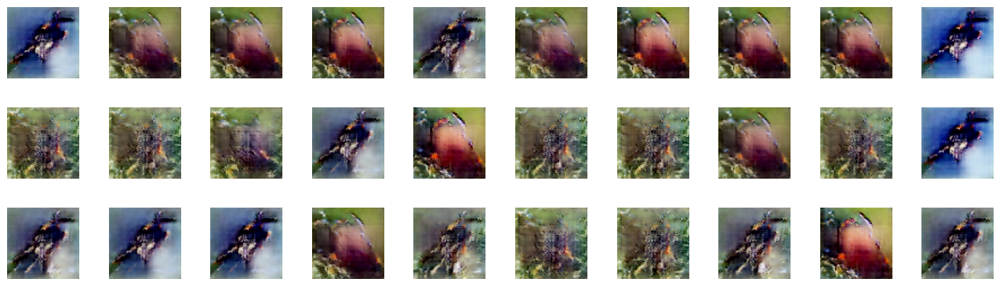

In [28]:
fig = plt.figure(figsize=(18, 5))
fig.subplots_adjust(hspace=0.4, wspace=0.4)

for i in range(grid_width * grid_height):
    ax = fig.add_subplot(grid_height, grid_width, i + 1)
    ax.axis("off")
    ax.imshow(reconstructions[i, :, :])

In [31]:
def compare_images(img1, img2):
    return np.mean(np.abs(img1 - img2))

In [32]:
all_data = []
for i in train.as_numpy_iterator():
    all_data.extend(i)
all_data = np.array(all_data)

In [33]:
all_data.shape

(84635, 64, 64, 3)

## Similar images in dataset as to generated images

1/1 [==============================] - 1s 570ms/step


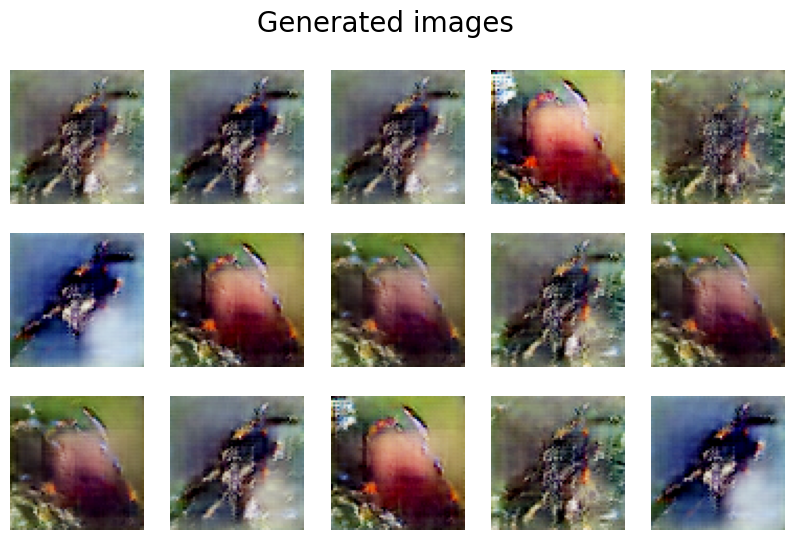

In [35]:
r, c = 3, 5
fig, axs = plt.subplots(r, c, figsize=(10, 6))
fig.suptitle("Generated images", fontsize=20)

noise = np.random.normal(size=(r * c, DIMS))
gen_imgs = generator.predict(noise)

cnt = 0
for i in range(r):
    for j in range(c):
        axs[i, j].imshow(gen_imgs[cnt], cmap="gray_r")
        axs[i, j].axis("off")
        cnt += 1

plt.show()

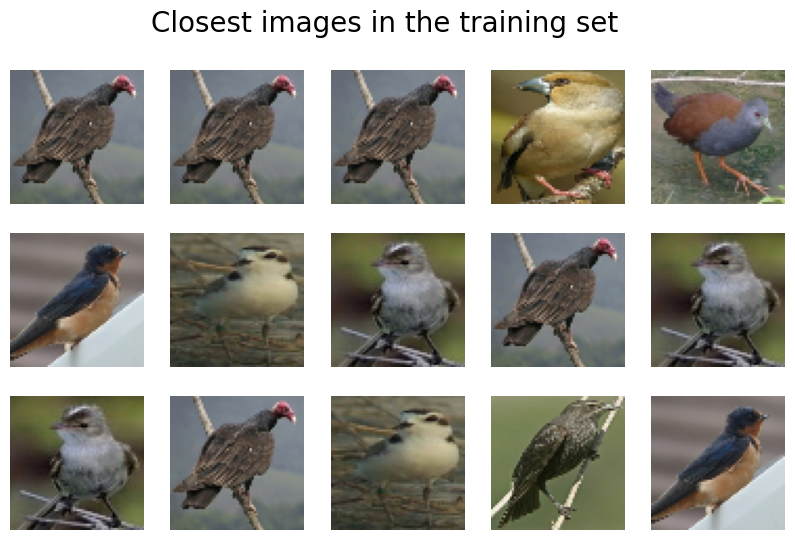

In [36]:
fig, axs = plt.subplots(r, c, figsize=(10, 6))
fig.suptitle("Closest images in the training set", fontsize=20)

cnt = 0
for i in range(r):
    for j in range(c):
        c_diff = 99999
        c_img = None
        for k_idx, k in enumerate(all_data):
            diff = compare_images(gen_imgs[cnt], k)
            if diff < c_diff:
                c_img = np.copy(k)
                c_diff = diff
        axs[i, j].imshow(c_img, cmap="gray_r")
        axs[i, j].axis("off")
        cnt += 1

plt.show()

1/1 [==============================] - 0s 19ms/step


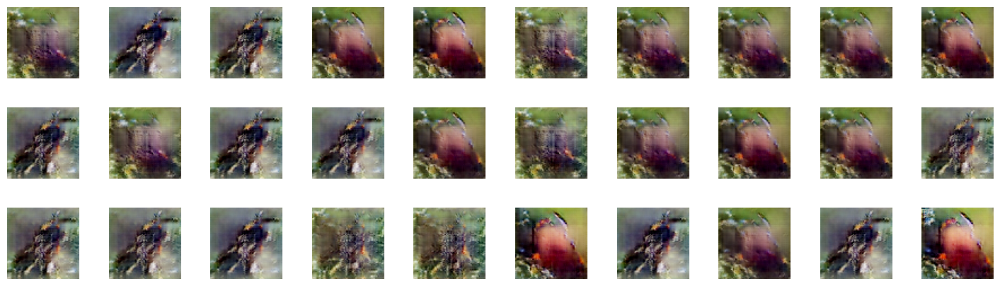

In [42]:
grid_width, grid_height = (10,3)
z_sample= np.random.normal(size=(grid_height* grid_width, DIMS))
reconstructions = generator.predict(z_sample)

fig = plt.figure(figsize=(18, 5))
fig.subplots_adjust(hspace=0.4, wspace=0.4)

for i in range(grid_width * grid_height):
    ax = fig.add_subplot(grid_height, grid_width, i + 1)
    ax.axis("off")
    ax.imshow(reconstructions[i, :, :])

1/1 [==============================] - 0s 21ms/step


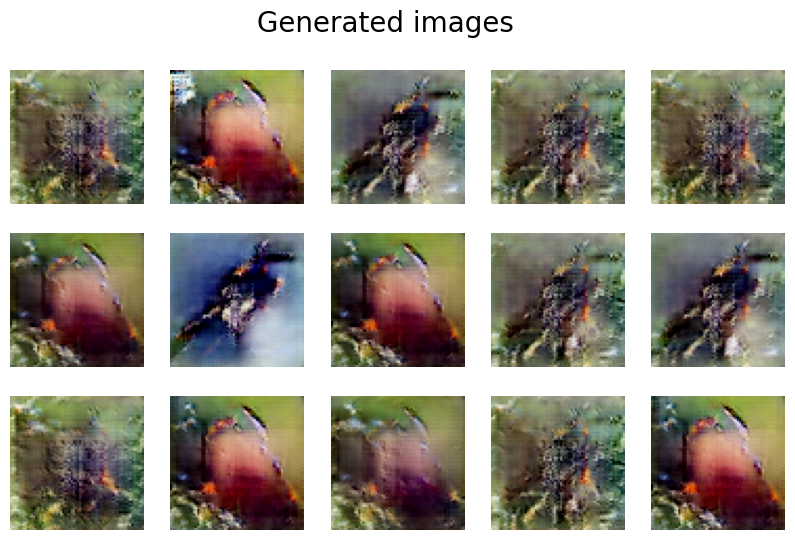

In [43]:
r, c = 3, 5
fig, axs = plt.subplots(r, c, figsize=(10, 6))
fig.suptitle("Generated images", fontsize=20)

noise = np.random.normal(size=(r * c, DIMS))
gen_imgs = generator.predict(noise)

cnt = 0
for i in range(r):
    for j in range(c):
        axs[i, j].imshow(gen_imgs[cnt], cmap="gray_r")
        axs[i, j].axis("off")
        cnt += 1

plt.show()

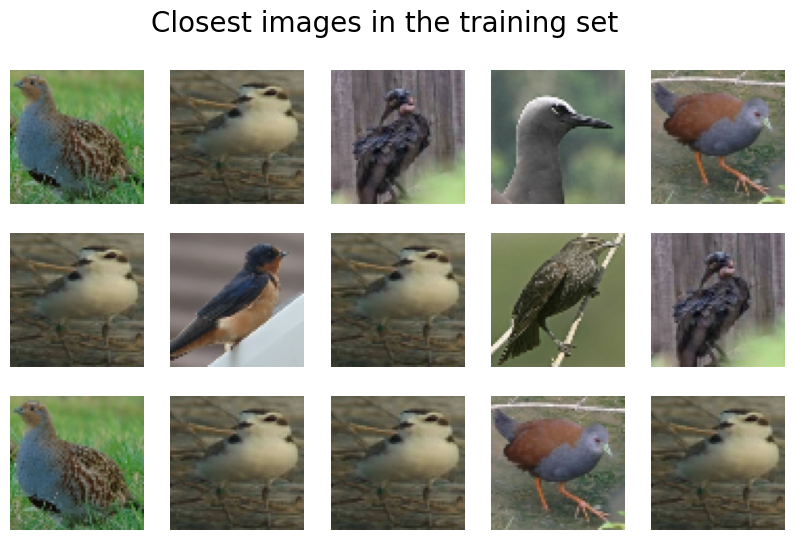

In [44]:
fig, axs = plt.subplots(r, c, figsize=(10, 6))
fig.suptitle("Closest images in the training set", fontsize=20)

cnt = 0
for i in range(r):
    for j in range(c):
        c_diff = 99999
        c_img = None
        for k_idx, k in enumerate(all_data):
            diff = compare_images(gen_imgs[cnt], k)
            if diff < c_diff:
                c_img = np.copy(k)
                c_diff = diff
        axs[i, j].imshow(c_img, cmap="gray_r")
        axs[i, j].axis("off")
        cnt += 1

plt.show()

As we can see, the model was only trained for 50 epochs and still generated something similar resemmbling a bird

Normally GANs need days worth of training to generate good results